<a href="https://colab.research.google.com/github/AdityaStark7/30daysofML-kaggle-Top-50/blob/main/xgbr_code.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import OrdinalEncoder
from sklearn.metrics import mean_squared_error

from IPython.display import clear_output
import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))


/kaggle/input/30-days-of-ml/sample_submission.csv
/kaggle/input/30-days-of-ml/train.csv
/kaggle/input/30-days-of-ml/test.csv
/kaggle/input/train-folds/train_folds.csv


In [ ]:
!pip install autoviz
!pip install xlrd

from autoviz.AutoViz_Class import AutoViz_Class
AV = AutoViz_Class()

clear_output()

In [ ]:
sample_submission = pd.read_csv("../input/30-days-of-ml/sample_submission.csv")

# AUTO EDA

    max_rows_analyzed is smaller than dataset shape 300000...
        randomly sampled 150000 rows from read CSV file
Shape of your Data Set loaded: (150000, 26)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
    Number of Numeric Columns =  15
    Number of Integer-Categorical Columns =  0
    Number of String-Categorical Columns =  7
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  3
    Number of Numeric-Boolean Columns =  0
    Number of Discrete String Columns =  0
    Number of NLP String Columns =  0
    Number of Date Time Columns =  0
    Number of ID Columns =  1
    Number of Columns to Delete =  0
    26 Predictors classified...
        This does not include the Target column(s)
        1 variables removed since they were ID or low-information variables
Since Number of Rows in data 150000 exceeds maximum, randomly sampling 150000 rows for EDA...
Number of All Scatter Plo

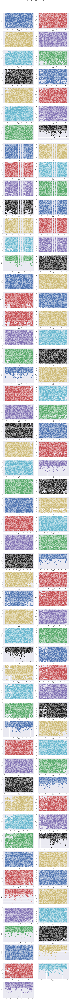

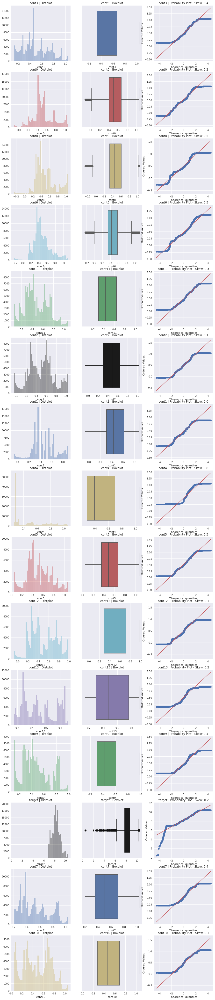

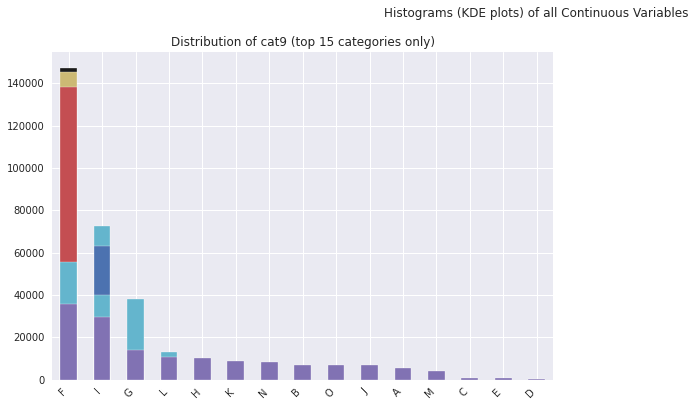

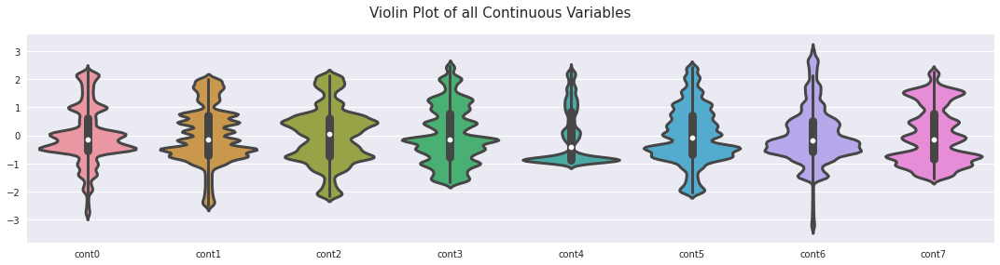

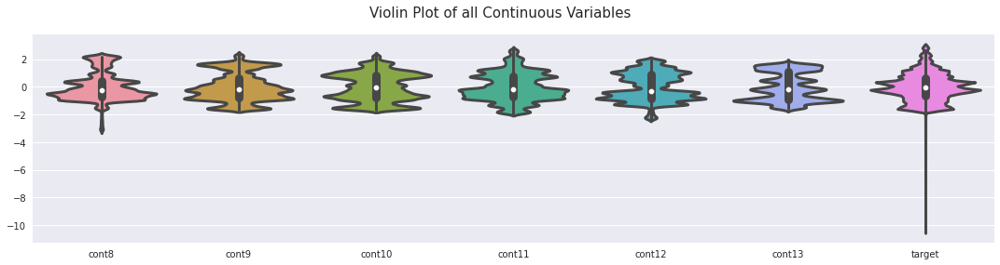

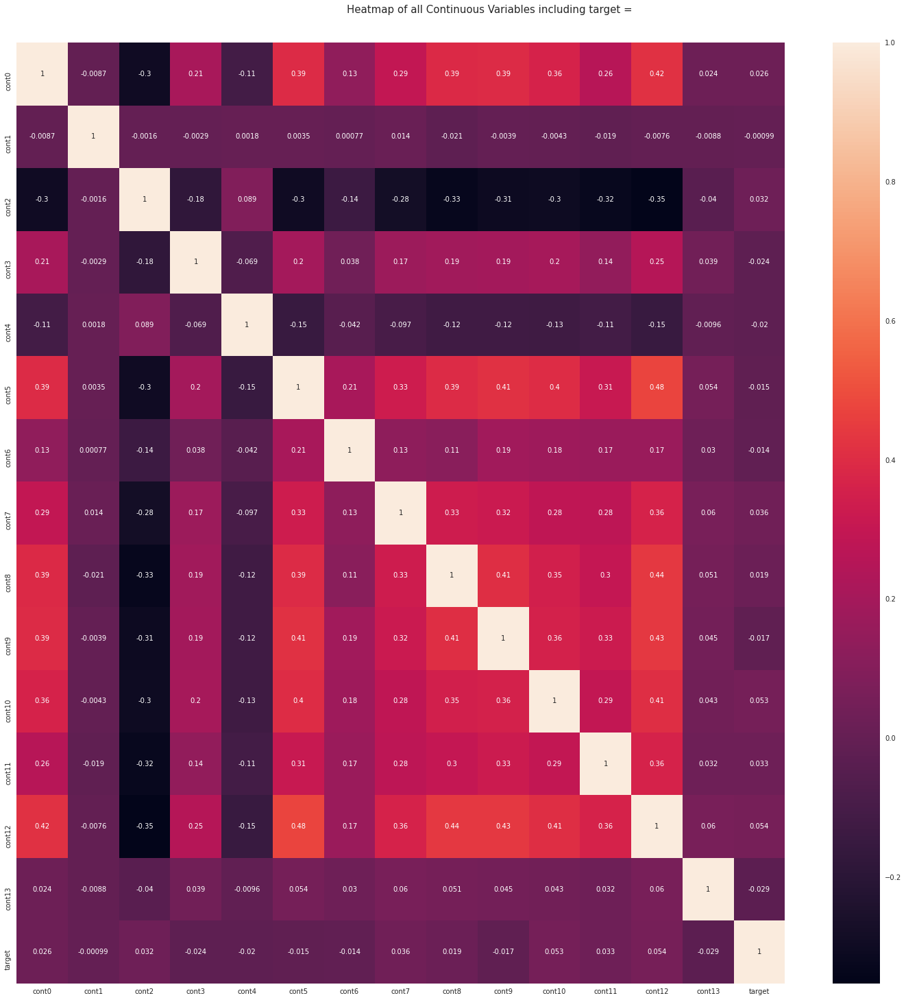

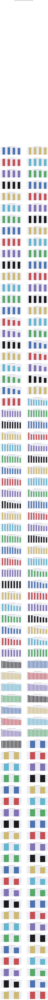

Time to run AutoViz (in seconds) = 121.013

 ###################### VISUALIZATION Completed ########################


In [ ]:
ff = AV.AutoViz('../input/30-days-of-ml/train.csv')

In [ ]:
!nvidia-smi

/bin/bash: nvidia-smi: command not found


# MODELING

In [ ]:
from xgboost import XGBRegressor
xgb_params = {
    'n_estimators': 4950,
    'learning_rate': 0.12,
    'subsample': 0.96,
    'colsample_bytree': 0.12,
    'max_depth': 2,
    'booster': 'gbtree', 
    'reg_lambda': 65.1,
    'reg_alpha': 15.9,
    'random_state':40
}


In [ ]:
df = pd.read_csv("/kaggle/input/train-folds/train_folds.csv")
df_test = pd.read_csv("../input/30-days-of-ml/test.csv")
sample_submission = pd.read_csv("../input/30-days-of-ml/sample_submission.csv")

useful_features = [c for c in df.columns if c not in ("id", "target", "kfold")]
object_cols = [col for col in useful_features if 'cat' in col]
df_test = df_test[useful_features]

# KFOLDS

This dataset is the same as abishek thakur created!

In [ ]:
final_predictions = []
for fold in range(5):
    xtrain =  df[df.kfold != fold].reset_index(drop=True)
    xvalid = df[df.kfold == fold].reset_index(drop=True)
    xtest = df_test.copy()

    ytrain = xtrain.target
    yvalid = xvalid.target
    
    xtrain = xtrain[useful_features]
    xvalid = xvalid[useful_features]
    
    ordinal_encoder = OrdinalEncoder()
    xtrain[object_cols] = ordinal_encoder.fit_transform(xtrain[object_cols])
    xvalid[object_cols] = ordinal_encoder.transform(xvalid[object_cols])
    xtest[object_cols] = ordinal_encoder.transform(xtest[object_cols])
    
    model = XGBRegressor(**xgb_params)
    model.fit(xtrain, ytrain)
    preds_valid = model.predict(xvalid)
    test_preds = model.predict(xtest)
    final_predictions.append(test_preds)
    print(f"fold: {fold}, rmse: {mean_squared_error(yvalid, preds_valid, squared=False)}")

fold: 0, rmse: 0.7160626395014544
fold: 1, rmse: 0.7161596047890887
fold: 2, rmse: 0.717998504311815
fold: 3, rmse: 0.7179942436422929
fold: 4, rmse: 0.7160660545522316


# PREDICTIONS

In [ ]:
preds = np.mean(np.column_stack(final_predictions), axis=1)
sample_submission.target = preds
sample_submission.to_csv("xgb_submission_k", index=False)